
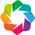

Loading BokehJS ...

In [1]:
import config
import imageNormalizer
from movie import Movie
import numpy as np
import holoviews as hv
hv.extension('bokeh')
import bokeh
from bokeh.io import output_notebook, show
import bokeh.plotting as bp # figure, show, output_file
output_notebook()

import matplotlib.pyplot as plt

from talk_plottingutils import plot_image_mpl, plot_image_rgb_bokeh, plot_image_bokeh, \
                               hv_plot_stack, plot_segmentation_bokeh, plot_segmentation

config.TTTDIR = '/home/michi/pythonProjects/deepLearning/Hemato_korea/data/'
m = Movie('experiment3', verbose=False)  # 140206

# Segmentation
        conda install opencv

Steps:

1. separate BG and FG: **MSER**
2. split clumped objects: **Watershed**

In [2]:
import cv2

# MSER

In [3]:
mser = cv2.MSER_create()

# MSER has a few parameters to be set
mser_delta = 1
mser_min = 20
mser_max = 4000
mser.setDelta(mser_delta)
mser.setMinArea(mser_min)
mser.setMaxArea(mser_max)

In [4]:
I = m.loadimage(position=54, timepoint=2855, WL='w00', extension='png', normalizer=imageNormalizer.NoNormalizer())
# I = m.loadimage(position=54, timepoint=3055, WL='w00', extension='png', normalizer=imageNormalizer.SLIC_Normalizer())

I = I - I.min()
I = I/I.max()
I = (I*2**8).astype('uint8')

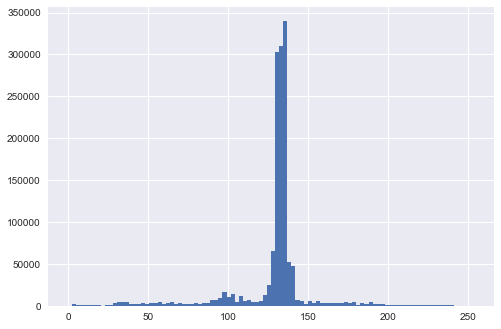

In [5]:
plt.hist(I.flatten(),100)
plt.show()

In [6]:
q = mser.detect(I)
len(q)
seg_centers = np.array([(_.pt[0], _.pt[1]) for _ in q])

In [7]:
# plt.figure();plot_image_mpl(I)
# plt.scatter(seg_centers[:,0], seg_centers[:,1], s=10)
# plt.show()

In [8]:
seg_centers.shape

(488, 2)

In [9]:
plot_image_bokeh(I, points=seg_centers)

Figure(id='8e38598c-4067-4789-8e3d-4e5802b10823', ...)

In [10]:
regions = mser.detectRegions(I, None)

def regions2mask(regions, ishape):
    bw = np.zeros(ishape)
    for r in regions:
        for i in range(len(r)): 
            bw[r[i,1], r[i,0]] = 1  # the usual row/col/x/y switch
    return bw

seg_mask = regions2mask(regions, I.shape)

In [11]:
# some postprocessing of the segmentation mask

from skimage.morphology import closing, opening, disk, dilation
from scipy.ndimage.morphology import binary_fill_holes, distance_transform_edt

bw_closed = closing(seg_mask, disk(2))
# TODO brige operation missing
filled_bw = binary_fill_holes(bw_closed)
opened_bw = opening(filled_bw, disk(2))
    
# plot_segmentation(I, opened_bw)
plot_segmentation_bokeh(I, opened_bw)

## Watershedding
to split merged objects.

1. find initial centers of cells: circular hough transform
2. watershedding starting from the centers

In [12]:
## find circles as initial points of watershed
#h_radii = np.arange(3,25)
#hough_stuff = hough_circle(I, radius=h_radii)
#accum, cx, cy, rad = hough_circle_peaks(hough_stuff, radii=h_radii,min_xdistance=5, min_ydistance=5, normalize=True)

# dist_transform = distance_transform_edt(opened_bw)
# plt.imshow(dist_transform)

### finding seeds for the watershed
i.e. the centers of the cells
- distance transform: distance of each pixel to the next background pixel

In [13]:
dist_transform = cv2.distanceTransform(opened_bw.astype('uint8'),cv2.DIST_L2,5)

d = (dist_transform- dist_transform.min())/ (dist_transform- dist_transform.min()).max() # normalization just for plotting
plot_segmentation_bokeh(I, d)

# plt.figure(figsize=(30,30))
# plot_segmentation(I, dist_transform)
# plt.show()

**Threshold the distance transform** to get pixels in the center of objects

In [14]:
threshold = 0.5*dist_transform.max()
threshold = 5
ret, sure_fg = cv2.threshold(dist_transform,threshold,255,0)
plot_image_bokeh(sure_fg)

Figure(id='3cd8341e-5ff5-4292-9dbb-d62f11ee9648', ...)

### actual watershed

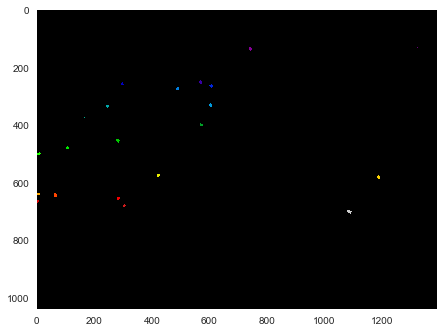

In [15]:
from skimage.measure import label
from skimage.morphology import watershed
markers = label(sure_fg)
plt.imshow(markers, cmap=plt.cm.nipy_spectral)
plt.grid()
plt.show()

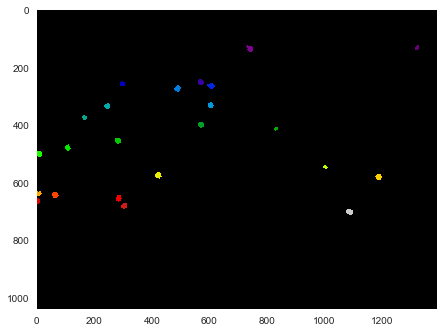

In [16]:
labels_ws = watershed(-dist_transform, markers, mask=opened_bw)
plt.imshow(labels_ws, cmap=plt.cm.nipy_spectral)
plt.grid()
plt.show()

In [17]:
plot_image_bokeh(labels_ws);

In [18]:
# filter out non-round and too large/small objects
eccfilter = 0.99;
ecccombfilter = 0.7;
maxsizecombfilter = 700;
minsize = 40;
maxsize = 1000;

filtered = np.zeros(labels_ws.shape, dtype=np.bool)
from skimage.measure import regionprops
for r in regionprops(labels_ws, intensity_image=None, cache=True):
    if not minsize < r.area < maxsize \
        or r.eccentricity >  eccfilter\
        or (r.eccentricity>ecccombfilter and r.area>maxsizecombfilter):
            
        filtered[labels_ws==r.label]= 1

labels_ws = labels_ws * (1-filtered)

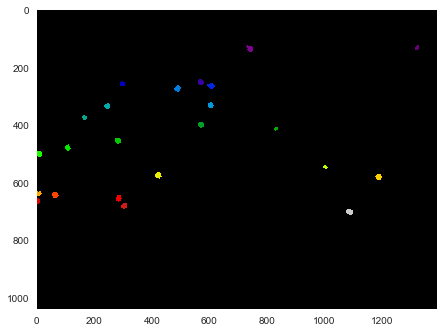

In [19]:
plt.imshow(labels_ws, cmap=plt.cm.nipy_spectral)
plt.grid()
plt.show()

### separate the objects in the segmentation mask
even though we know the individual cells no, let split them in the segmentation mask

In [20]:
from skimage.segmentation import find_boundaries, mark_boundaries

outer_bound = find_boundaries(labels_ws, mode='outer')
touching_object_pixels = outer_bound * opened_bw

# set these touching pixels to background in the segmantation mask (so that the obejcts are distinct)
final_segmentation = labels_ws > 0
final_segmentation[touching_object_pixels==True] = 0

In [21]:
# plot_segmentation(I, final_segmentation)
# plt.show()

In [22]:
plot_segmentation_bokeh(I, final_segmentation)

# Loading preexisting segmentation

SLIC: loading matfile /home/michi/pythonProjects/deepLearning/Hemato_korea/data//experiment3/experiment3_p0054//../background_SLIC/experiment3_p0054_2001-3000_w00.png_SLIC.mat
{'x': 740.3384615384615, 'y': 134.7076923076923, 'position': 54, 'timepoint': 2855, 'area': 130, 'w01': None, 'w02': None, 'w03': None, 'w01_SLIC': None, 'w02_SLIC': None, 'w03_SLIC': None, 'h5counter': 0, 'uniqueKey': 'p54_t2855_0'}


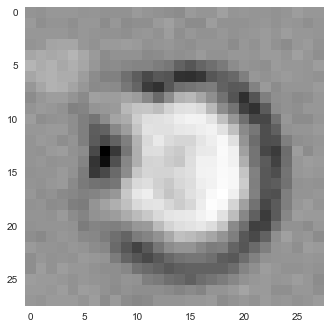

In [23]:
# get all segmented objects from a time/position
properties, images, cropped_flag = m.get_segmented_objects_from_images(timepoint=2855, position=54)

print(properties[0]) # properies of the first segmented object
plt.imshow(images[0]); plt.grid(); plt.show() # image of that cell

lets compare to our segmentation

In [25]:
seg_objs_centroids = [(info['x'], info['y']) 
                      for info in m.get_segmented_objects_from_images(timepoint=2855, position=54)[0]]
seg_objs_centroids = np.array(seg_objs_centroids)

In [26]:
plot_image_bokeh(I, points=seg_objs_centroids);

Figure(id='83152457-1adb-4408-80d8-f02dad9ad6b1', ...)

## Cells over time
Looking at the number of segmented objects over time in the two positions


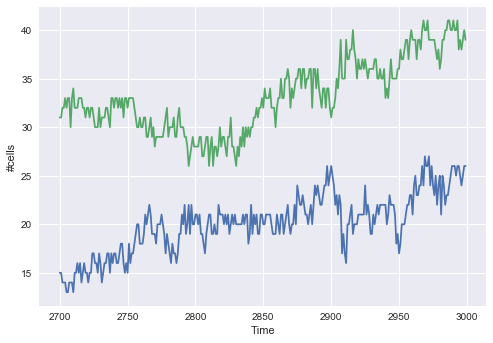

In [41]:
import itertools
import toolz
plt.figure()
for pos in [54,55]:
    prop_generator = (m.get_segmented_objects_from_images(timepoint=_, position=pos)[0] for _ in range(2700,3000))
    Q = toolz.concat(prop_generator)
    timepoints = toolz.pluck('timepoint', Q)
    timepoint_histogram = toolz.frequencies(timepoints)
    t, freq = list(zip(*timepoint_histogram.items()))
    plt.plot(t,freq)
    plt.xlabel('Time')
    plt.ylabel('#cells')
plt.show()

In [30]:
prop_generator = (m.get_segmented_objects_from_images(timepoint=_, position=54)[0] for _ in range(2700,3000))
Q = toolz.concat(prop_generator)
xyta = toolz.pluck(['x','y','timepoint', 'area'], Q)
x,y,t, a = zip(*xyta)

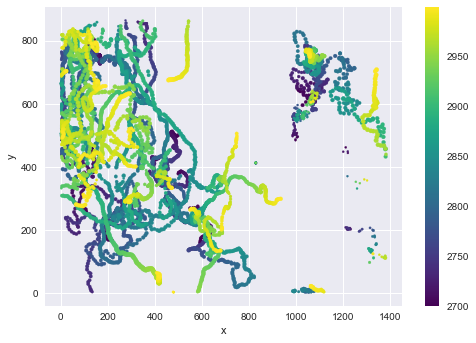

In [31]:
plt.scatter(x,y,c=t, s=np.array(a)*0.1, cmap=plt.cm.viridis)
plt.xlabel('x')
plt.ylabel('y')
plt.colorbar()
plt.show()

In [32]:
from talk_utils import tile_raster_images
img_generator = (np.stack(m.get_segmented_objects_from_images(timepoint=_, position=54)[1]) for _ in range(2700,2800))
cell_imgs = np.concatenate(list(img_generator), axis=0)

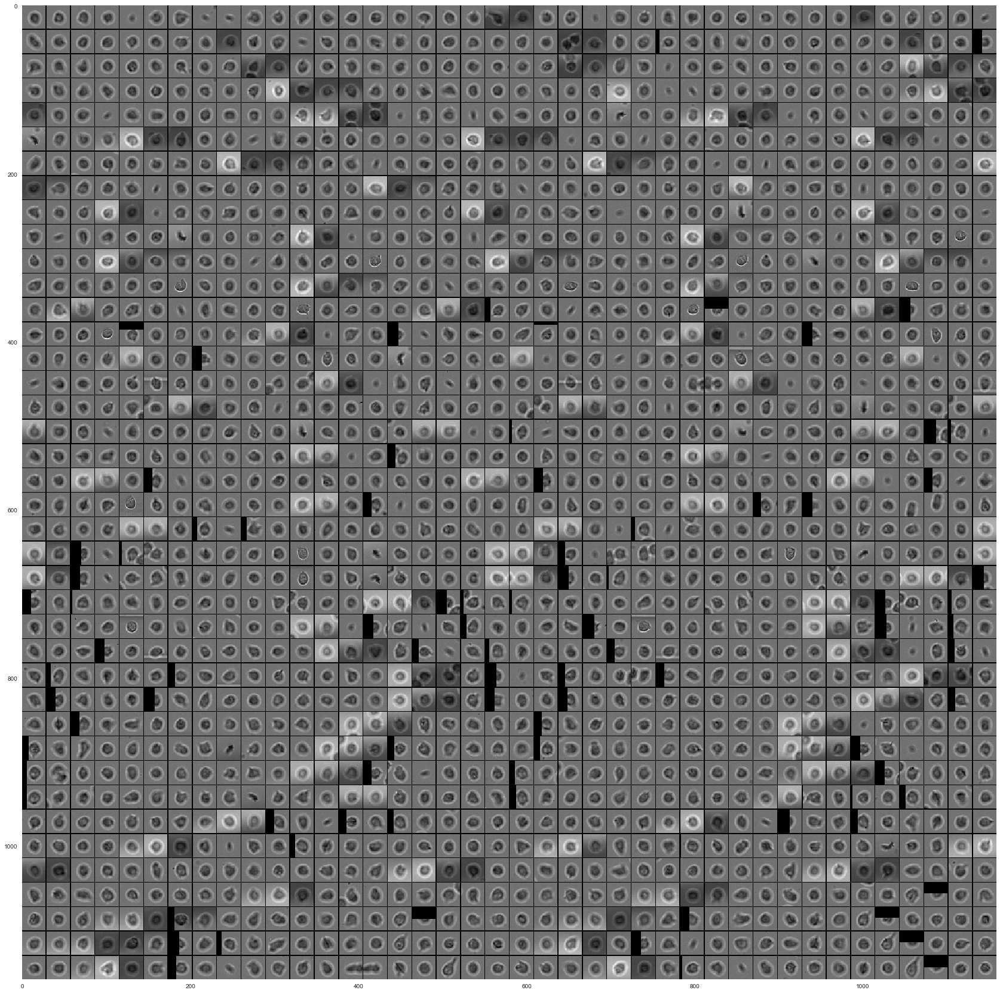

In [39]:
tile_raster_images(cell_imgs, img_dim=(1,2), tile_shape=(40,40), figsize=(30,30))
plt.grid()
plt.show()